# Temperature convolution experiment
So we know that all velocity channels contain components of other velocity
channels due to thermal broadening:
$$
  v_{thermal}=\mathbb{G}\left(v, \sqrt{\frac{k_BT}{m_{HI}}}\right)
$$
Where $T_{WNM}=5\cdot10^3K$ and $\sigma=6kms^{-1}$. To compensate for this
thermal broadening, we should convolve the intensity along the velocity axis
with a gaussian.
$$
  v_{true}=v_{thermal}*\mathbb{G}\left(0, \sqrt{\frac{k_BT}{m_{HI}}}\right)
$$
Which is
$$
  v_{true}=\mathcal{F}^{-1}\left(\mathcal{F}(v_{thermal})\mathbb{G}(0,\sigma^{-1})\right)

In [1]:
from astropy.io import fits
from matplotlib import pyplot as plt
import numpy as np
import gc

# matplotlib configuration
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.autolayout'] = True
plt.rcParams['savefig.dpi'] = 300
plt.rcParams['figure.figsize'] = (3.27, 2)
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['lines.linewidth'] = 1
plt.rcParams['axes.linewidth'] = 1
plt.rcParams['legend.fontsize'] = 10
plt.rcParams["savefig.bbox"] = 'tight'
plt.rcParams['savefig.pad_inches'] = 0.3
plt.rcParams['font.family'] = 'Fira Code'
plt.rcParams['mathtext.fontset'] = 'custom'
plt.rcParams['mathtext.rm'] = 'Fira Code'
plt.rcParams['mathtext.it'] = 'Fira Code'
plt.ioff()

/usr/lib/python3.11/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


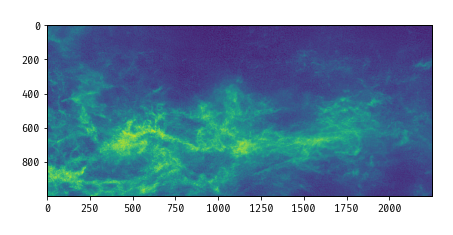

In [2]:
path = f"/home/raulwolters/Documents/galactic bubbles/full_cube.fits"
plane = fits.open(path)[0].data

plt.figure(figsize=(6,6))
plt.imshow(plane[182])
plt.show()

In [3]:
#plot van de integrated density vs snelheid
N_CHANNELS = 272
V_STEP = -0.82446
V_REF = -60

#snelheid is TOV zon
v = np.linspace(0, V_STEP*N_CHANNELS, num=N_CHANNELS)
v = v - (v[145] - V_REF)

#gegokte begin/eindpunten van spiraalarmen
cygnus = (25, -25)
perseus = (-30, -50)
norma = (-65, -85)

#marginalised velocity
intensity = np.nansum(plane, (1, 2))
intensity = intensity / np.max(np.abs(intensity))

findfont: Font family ['cursive'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'cursive' not found because none of the following families were found: Apple Chancery, Textile, Zapf Chancery, Sand, Script MT, Felipa, Comic Neue, Comic Sans MS, cursive


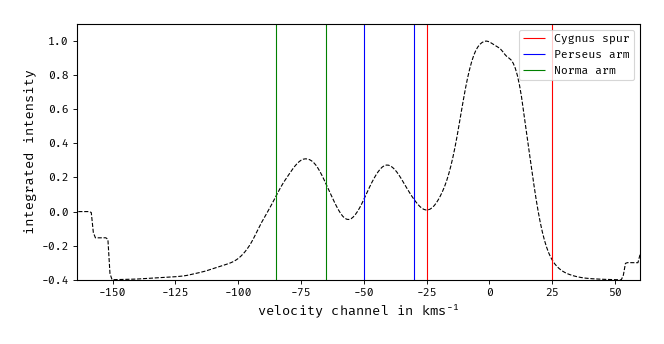

In [4]:
#locations of the three spiral arms
V_CYGNUS = 0.4575227533295405
V_PERSEUS = -40.24883719196908
V_NORMA = -73.48343379792837

SIG_CYGNUS = 9.623279036953413
SIG_PERSEUS = 5.956261034405368
SIG_NORMA = 6.469301229843046

#make plot
plt.figure(figsize=(8, 4), dpi=80)
plt.plot(v, intensity, color='black', linestyle='--')
#arms
plt.vlines(cygnus, -1e9, 1e9, color='red', label='Cygnus spur')
plt.vlines(perseus, -1e9, 1e9, color='blue', label='Perseus arm')
plt.vlines(norma, -1e9, 1e9, color='green', label='Norma arm')
plt.legend()
plt.xlim(np.min(v), np.max(v))
plt.ylim(np.min(intensity), np.max(intensity)*1.1)
plt.xlabel("velocity channel in $kms^{-1}$")
plt.ylabel("integrated intensity")
plt.show()

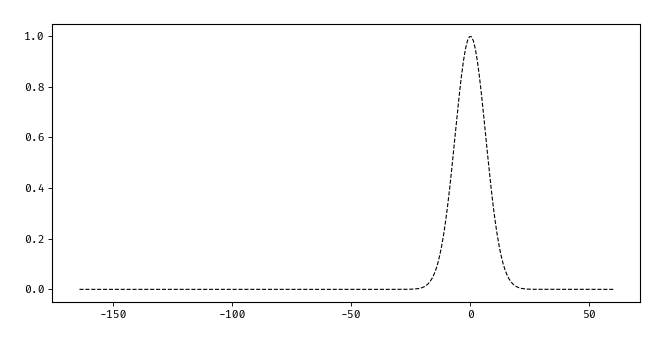

In [5]:
def gauss(x, *p):
  A, mu, sigma = p
  return A*np.exp(-(x-mu)**2/(2.*sigma**2))

sigma = 6.422532702

#make plot
plt.figure(figsize=(8, 4), dpi=80)
plt.plot(v, gauss(v, 1, 0, sigma), color='black', linestyle='--')
plt.show()

In [6]:
v_k = np.fft.fft(intensity)
G_k = np.fft.fft(gauss(v, 1, 0, 6))
corr = np.real(np.fft.ifft(v_k / G_k))
corr = corr / np.max(corr)

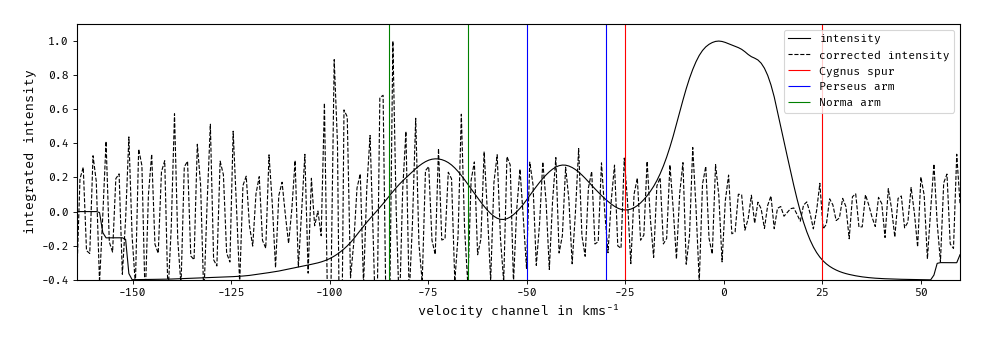

In [7]:
#make plot
plt.figure(figsize=(12, 4), dpi=80)
plt.plot(v, intensity, color='black', linestyle='-', label='intensity')
plt.plot(v, corr, color='black', linestyle='--', label='corrected intensity')
#arms
plt.vlines(cygnus, -1e9, 1e9, color='red', label='Cygnus spur')
plt.vlines(perseus, -1e9, 1e9, color='blue', label='Perseus arm')
plt.vlines(norma, -1e9, 1e9, color='green', label='Norma arm')
plt.legend()
plt.xlim(np.min(v), np.max(v))
plt.ylim(np.min(intensity), np.max(intensity)*1.1)
plt.xlabel("velocity channel in $kms^{-1}$")
plt.ylabel("integrated intensity")
plt.show()

In [8]:
#let's try that with the full image
selection = np.ma.masked_where(
  (v >= -100) & (v <= 25),
  v
).mask

G = gauss(v[selection], 1, 0, sigma)
G_k = np.fft.fftshift(np.fft.fft(G))

gc.collect()
plane_k = np.fft.fftshift(np.fft.fft(plane[selection, :, :], axis=0), axes=(0))
plane_k = plane_k / G_k[:,None,None]
plane_corr = np.fft.ifft(np.fft.ifftshift(plane_k, axes=(0)), axis=0)
del plane_k
gc.collect()

0

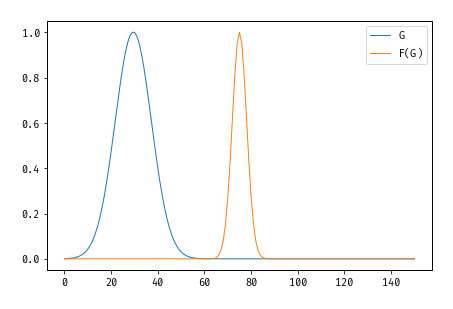

In [9]:
plt.plot(G/np.max(G), label='G')
plt.plot(abs(G_k/np.max(G_k)), label='$\mathcal{F}(G)$')
plt.legend()
plt.show()

/tmp/ipykernel_36806/3547719204.py:9: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.savefig(f'./thermal corrections/img{idx}.png')
/tmp/ipykernel_36806/3547719204.py:10: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


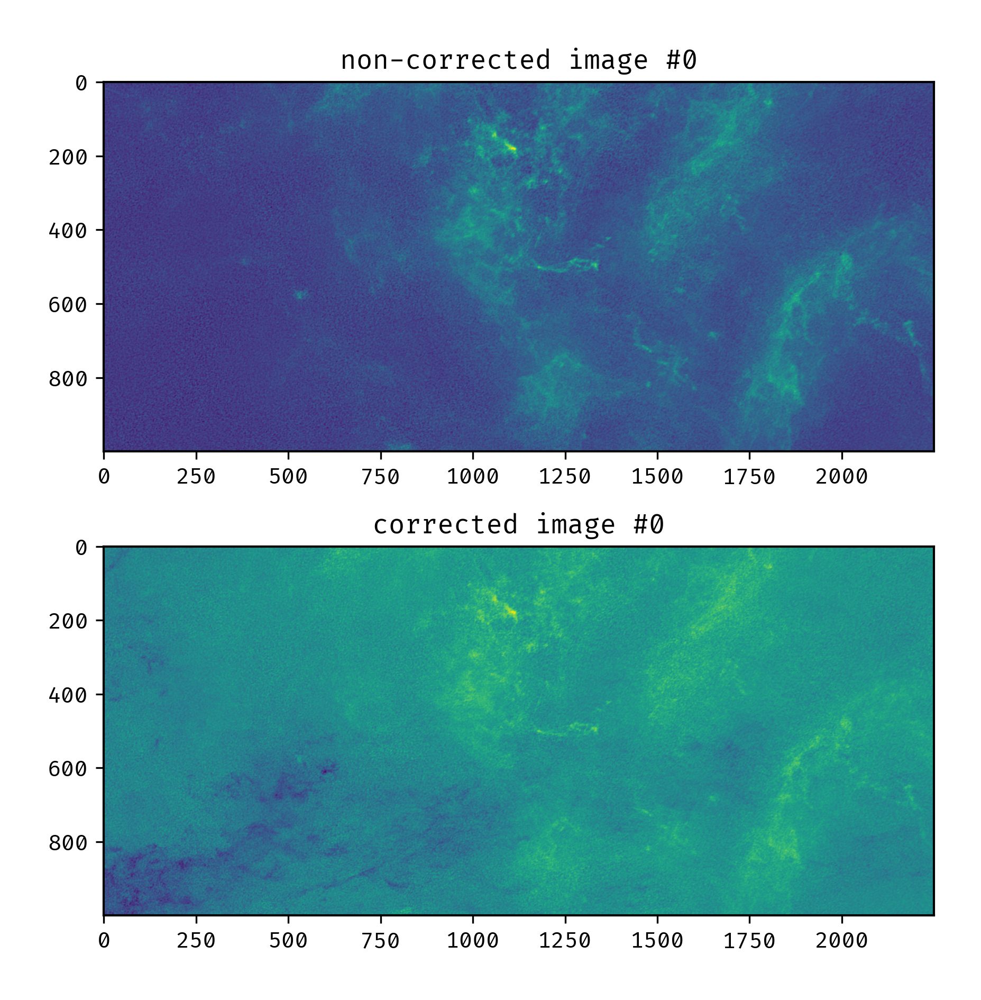

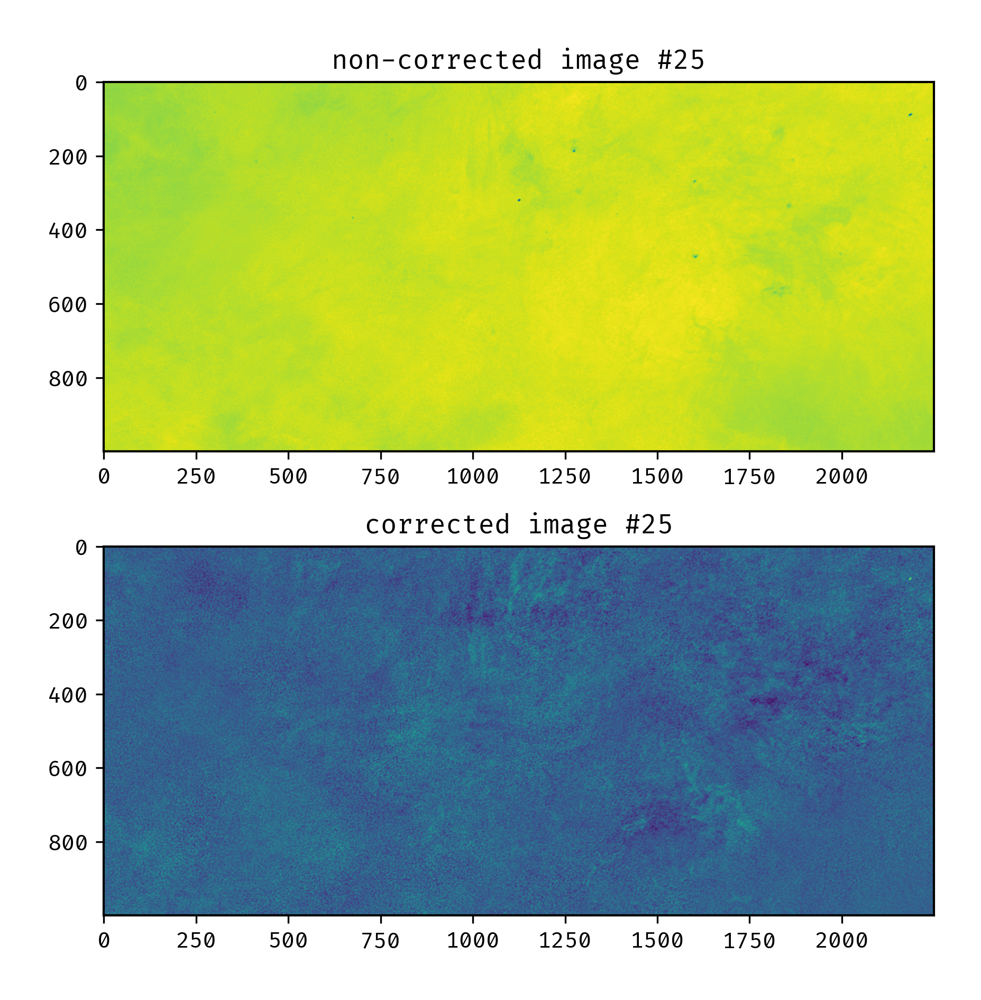

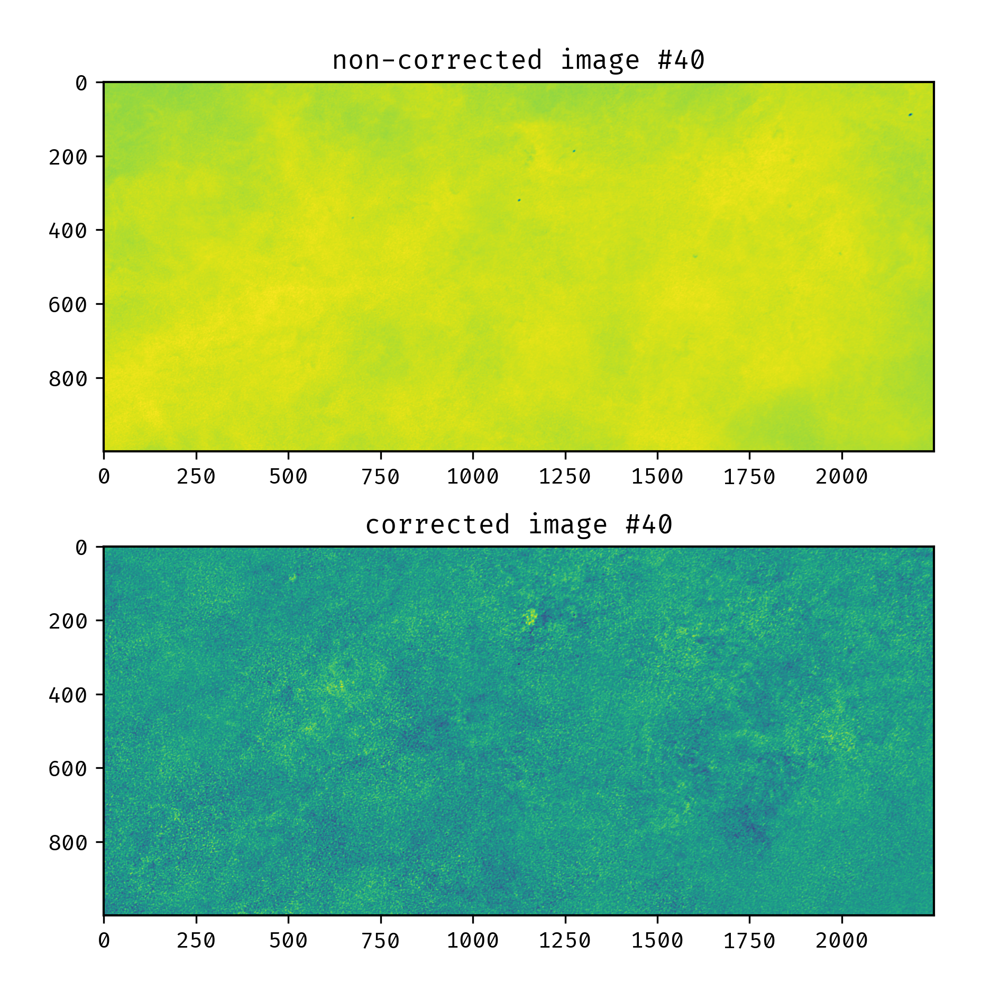

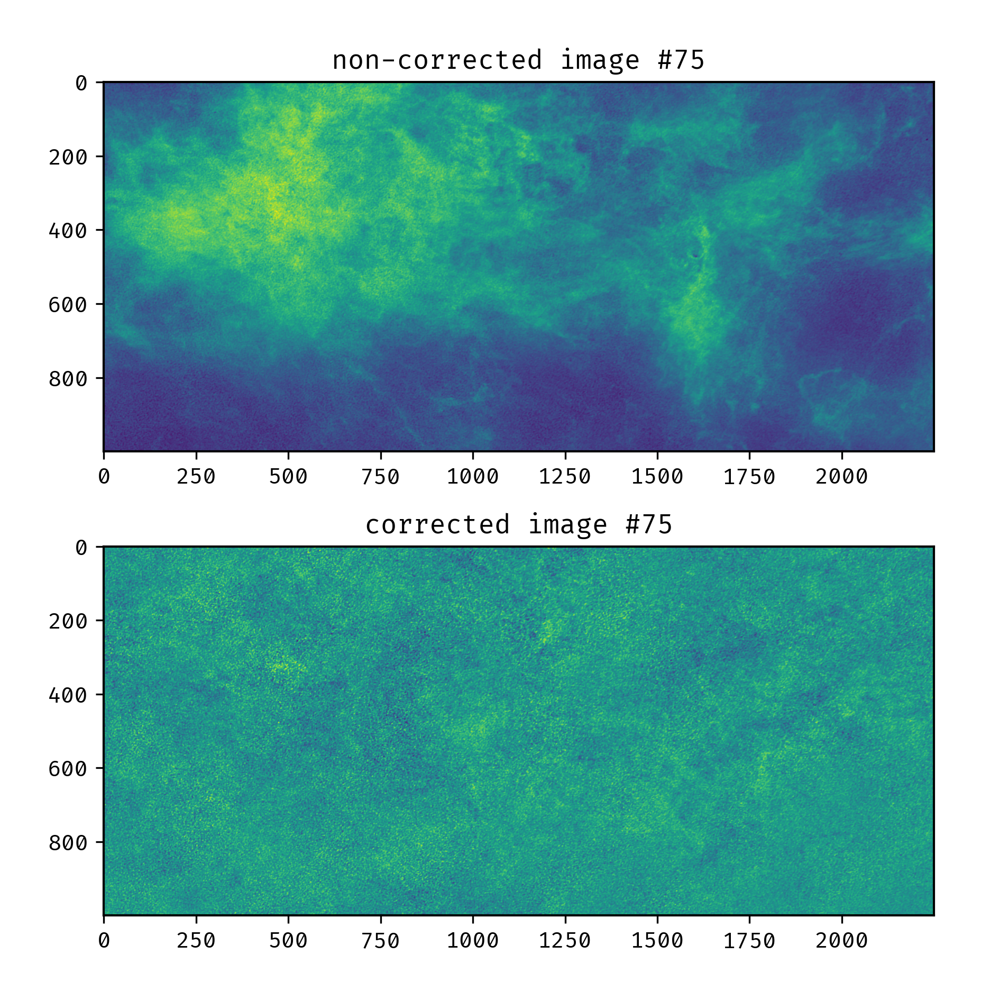

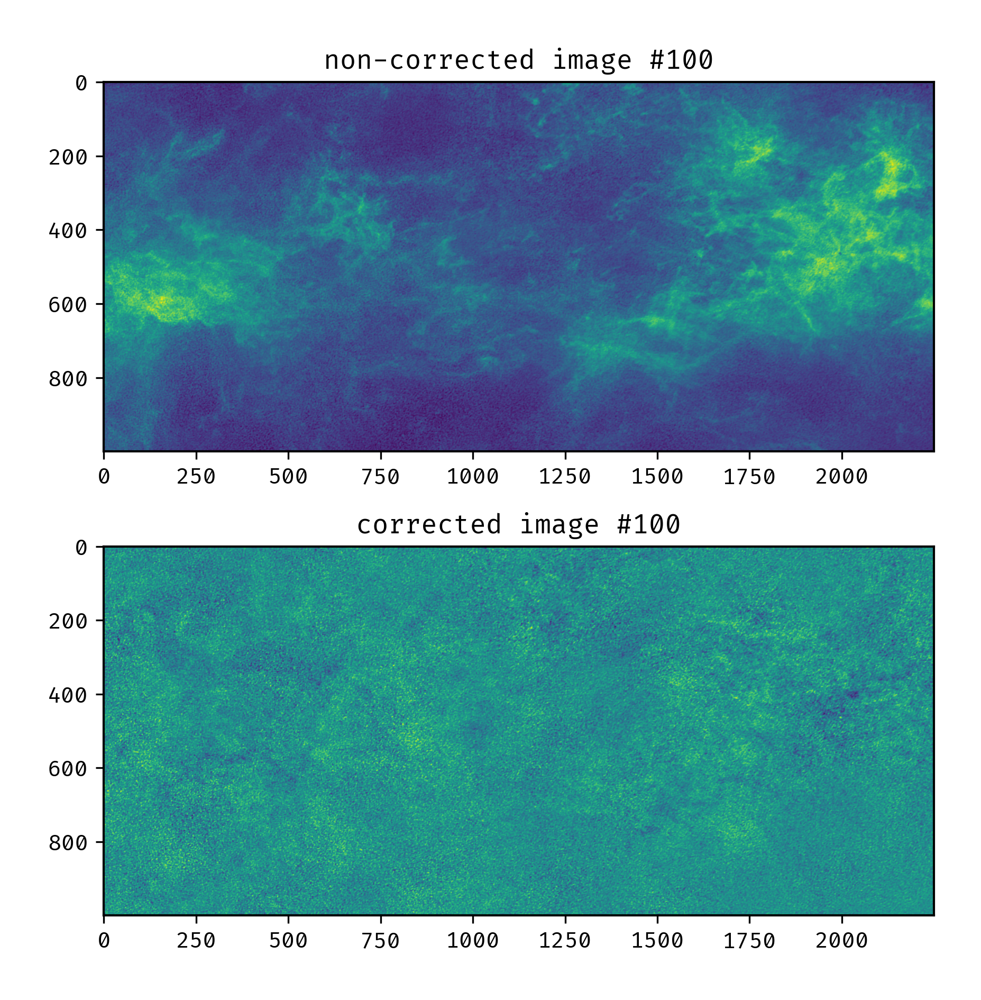

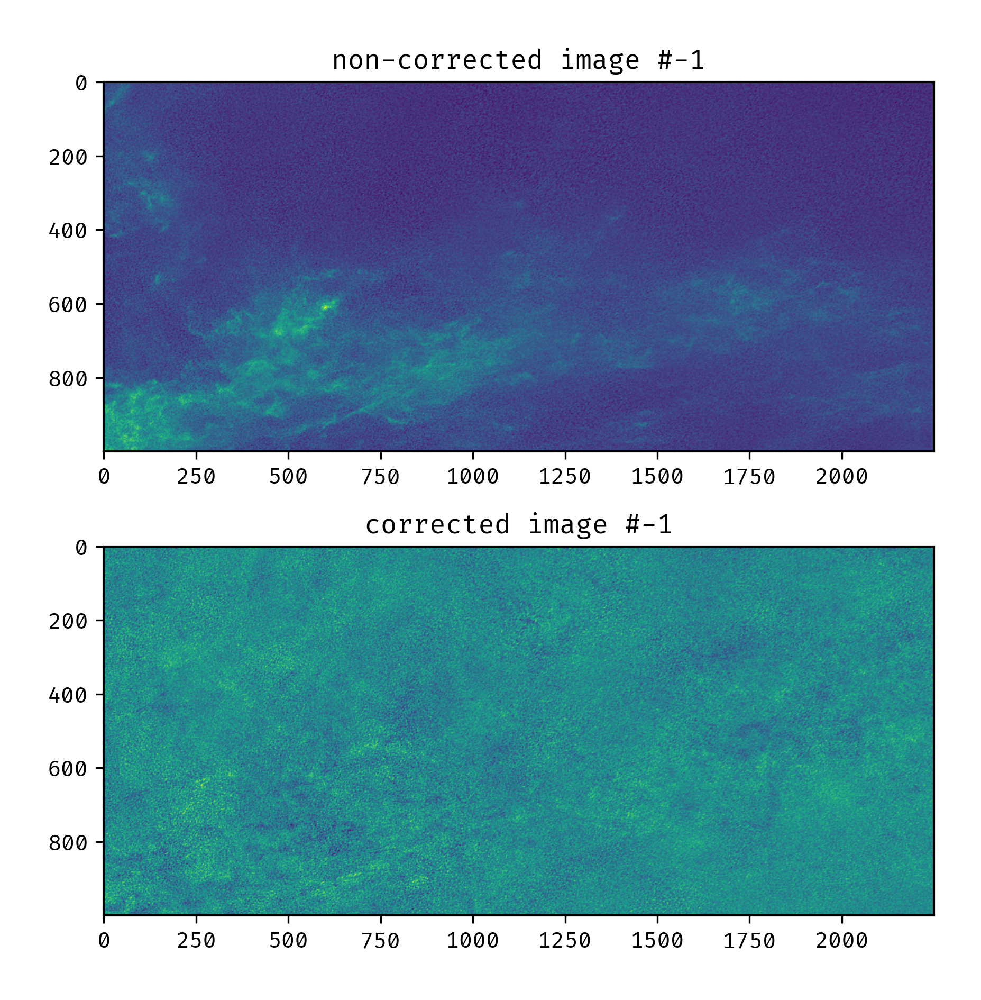

In [10]:
imgs = [0, 25, 40, 75, 100, -1]

for idx in imgs:
  fig, axs = plt.subplots(2, figsize=(6,6), dpi=300)
  axs[0].imshow(plane[selection][idx])
  axs[0].set_title(f"non-corrected image #{idx}")
  axs[1].imshow(np.real(plane_corr[idx]))
  axs[1].set_title(f"corrected image #{idx}")
  fig.savefig(f'./thermal corrections/img{idx}.png')
  fig.show()

/usr/lib64/python3.11/site-packages/matplotlib/cbook/__init__.py:1369: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


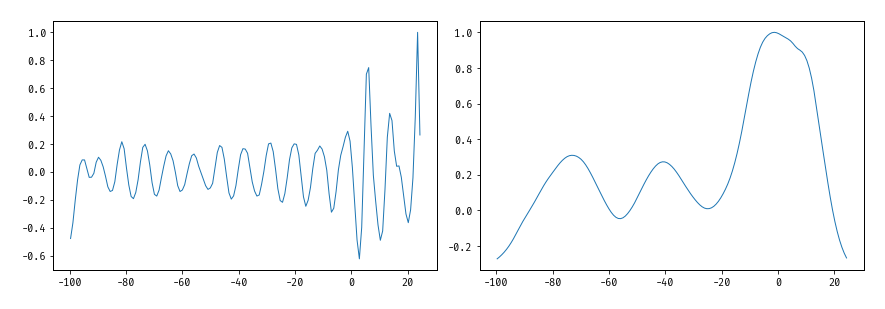

In [11]:
intensity_corr = np.nanmean(plane_corr, axis=(1,2))
intensity_corr = intensity_corr / np.max(intensity_corr)

fig, axs = plt.subplots(1,2, figsize=(12,4))
axs[0].plot(v[selection], intensity_corr)
axs[1].plot(v[selection], intensity[selection])
plt.show()

## Selective corrections?
Resultaten dusverre zijn niet heel spannend. Misschien is het wat om de thermal correction alleen toe te passen op kleine schalen, en de rest met rust te laten.